### Compte Rendu du TP : Estimation du Mouvement

### Binome :
- NAIT ACHOUR Younes 28717789
- HAMDI Massyl Yanis 2118208

In [1]:
from skimage import io
from script import Image_processing, Coins_detector, Matching
import matplotlib.pyplot as plt 
import numpy as np
import time
import glob
import os

In [2]:
# Charger toutes les images .JPG du dossier "Docs\pics" dans une liste
images = [io.imread(file) for file in glob.glob("Docs\pics\*.JPG")]
titles =  [os.path.basename(file) for file in glob.glob("Docs\pics\*.JPG")]

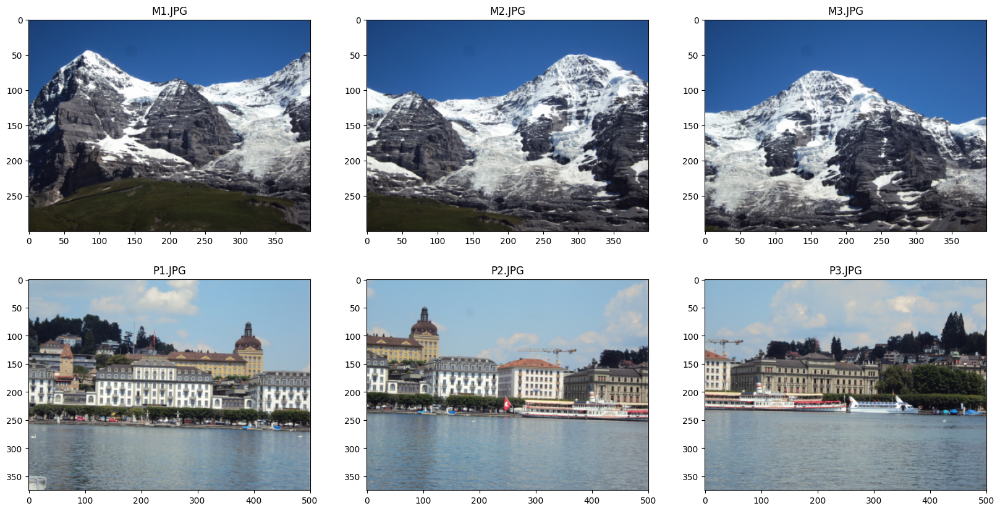

In [3]:
#afficher les images contenues dans la liste images 
fig, ax = plt.subplots(nrows=2, ncols=3, figsize=(20, 10))
for i, img in enumerate(images):
    ax[(i//3), (i % 3)].imshow(images[i], cmap='gray')
    ax[(i//3), (i % 3)].set_title(f"{titles[i]}")

## EXERCICE 01 : Détection des points d'interets


- ### Détecteur de harris 

##### Algorithme :

1 - Calculez les dérivées de l'image par rapport à x et y.

2 - Appliquez des fenêtres de convolution pour calculer les produits de convolution des dérivées.

3 - Utilisez ces produits de convolution pour construire la matrice de Harris.

$$ M = 
\begin{pmatrix}
\sum{I_x^2} & \sum{I_xI_y}\\
\sum{I_xI_y} & \sum{I_y^2}
\end{pmatrix}
$$


4 - Calculer la réponse du détecteur de Harris.

5 - Suppression des non-maxima : Appliquez une suppression des non-maxima pour obtenir les coins détectés.

**(a) Implémentation du détecteur de Harris en utilisant deux modes (Rectangulaire,  Gaussienne).**

- Harris detector avec une fenétre rectangulaire

Text(0.5, 0.98, 'Harris detector avec une fenétre rectangulaire')

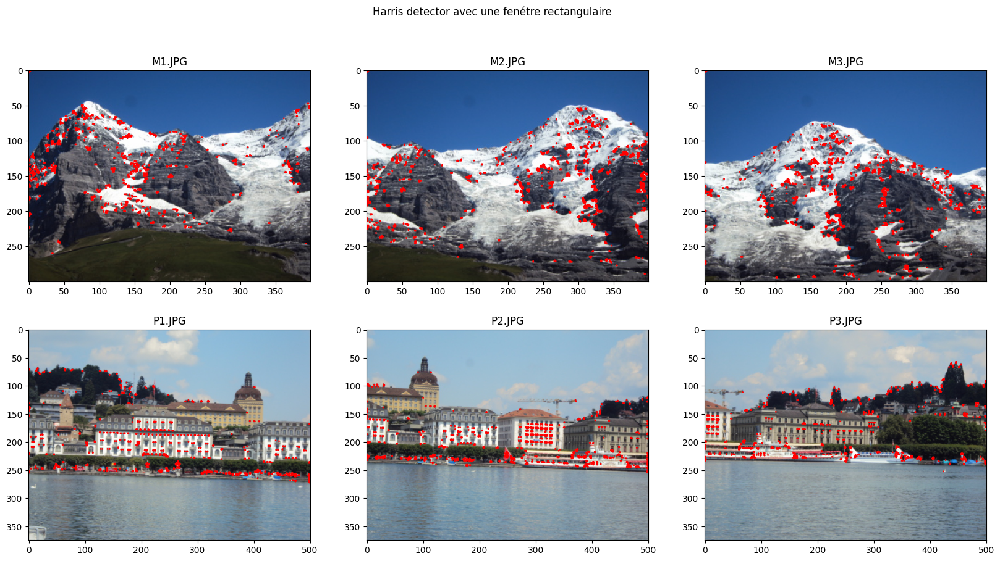

In [4]:
Dectecteur = Coins_detector()
fig, ax = plt.subplots(nrows=2, ncols=3, figsize=(20, 10))
for i, img in enumerate(images):
    _, keypoints = Dectecteur.haris_detector(img, K = 0.04, methods_wds='rectangulaire', size_wds = 3)
    ax[(i//3), (i % 3)].imshow(images[i], cmap='gray')
    ax[(i//3), (i % 3)].scatter(keypoints[:, 1], keypoints[:, 0],s =1, facecolors='none', edgecolors='r')
    ax[(i//3), (i % 3)].set_title(f"{titles[i]}")
fig.suptitle("Harris detector avec une fenétre rectangulaire")


- Harris detector avec une fenétre gaussienne

Text(0.5, 0.98, 'Harris detector avec une fenétre gaussienne')

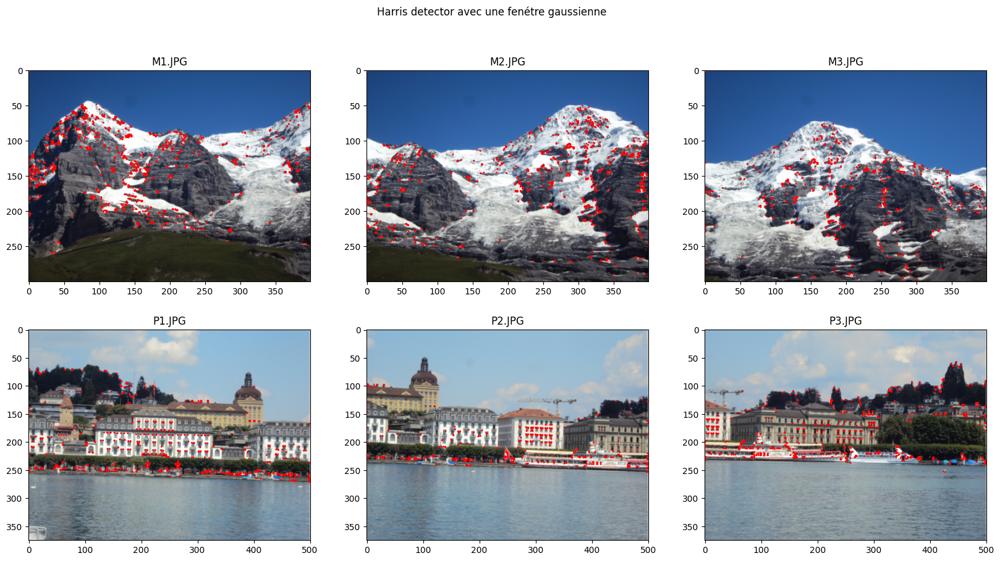

In [5]:

fig, ax = plt.subplots(nrows=2, ncols=3, figsize=(20, 10))
for i, img in enumerate(images):
    _, keypoints = Dectecteur.haris_detector(img, K = 0.04, methods_wds='gaussienne', std_dev = 0.5)
    ax[(i//3), (i % 3)].imshow(images[i], cmap='gray')
    ax[(i//3), (i % 3)].scatter(keypoints[:, 1], keypoints[:, 0],s =1, facecolors='none', edgecolors='r')
    ax[(i//3), (i % 3)].set_title(f"{titles[i]}")
fig.suptitle("Harris detector avec une fenétre gaussienne")

**Remarque** : la fenêtre choisie influence sur la sensibilité du détecteur aux variations. Une fenêtre gaussienne donne des résultats lissés et robustes au bruit, tandis qu'une fenêtre rectangulaire peut être plus sensible aux détails fins mais aussi au bruit.

**(b) Implémentation d'une suppression des non-maxima locaux.**

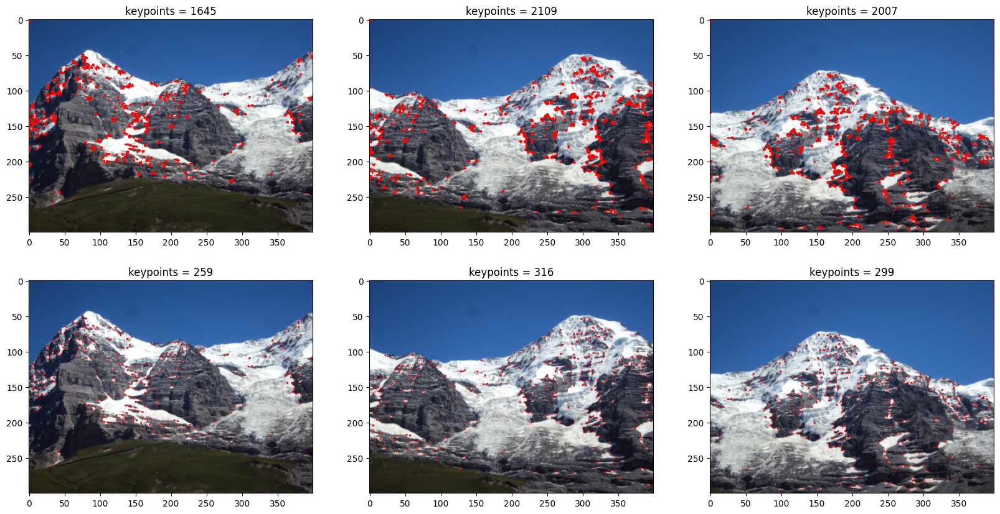

In [6]:
fig, ax = plt.subplots(nrows=2, ncols=3, figsize=(20, 10))
for i, img in enumerate(images[: 3]):
    _, keypoints_nosuppression = Dectecteur.haris_detector(img, K = 0.04, methods_wds='rectangulaire', size_wds = 3, remover=False)
    _, keypoints_suppression = Dectecteur.haris_detector(img, K = 0.04, methods_wds='rectangulaire', size_wds = 3, remover=True, suppression_size=5)
    ax[0, (i % 3)].imshow(img, cmap='gray')
    ax[0, (i % 3)].scatter(keypoints_nosuppression[:, 1], keypoints_nosuppression[:, 0],s =1, facecolors='none', edgecolors='r')
    ax[0, (i % 3)].set_title(f"keypoints = {len(keypoints_nosuppression)}")
    ax[1, (i % 3)].imshow(img, cmap='gray')
    ax[1, (i % 3)].scatter(keypoints_suppression[:, 1], keypoints_suppression[:, 0],s =1, facecolors='none', edgecolors='r')
    ax[1, (i % 3)].set_title(f"keypoints = {len(keypoints_suppression)}")

**Remarque** : Les non-maxima locaux aident à affiner les résultats, en ne conservant que les points saillants.

**(c) Etudier l'influence du type de fenêtre de pondération et de sa taille et du paramètre k.**

k = 0.04 nombre de point 1645
k = 0.05 nombre de point 1546
k = 0.06 nombre de point 1495


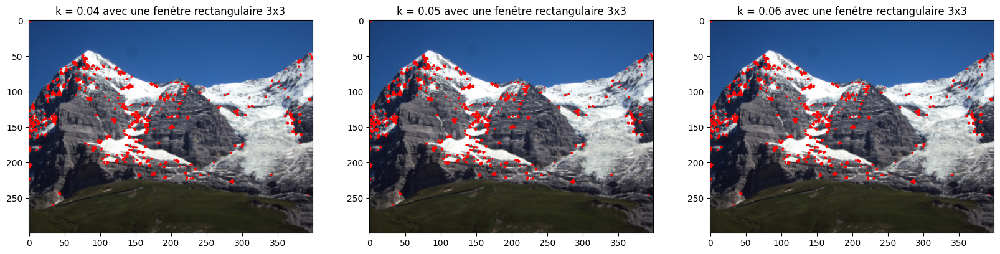

In [7]:
k = [0.04, 0.05, 0.06]
fig, ax = plt.subplots(nrows=1, ncols=3, figsize=(20, 10))
for i in range(3):
    _, keypoints = Dectecteur.haris_detector(images[0], K = k[i], methods_wds='rectangulaire', size_wds = 3)
    ax[(i % 3)].imshow(images[0], cmap='gray')
    ax[(i % 3)].scatter(keypoints[:, 1], keypoints[:, 0],s =1, facecolors='none', edgecolors='r')
    ax[(i % 3)].set_title(f"k = {k[i]} avec une fenétre rectangulaire 3x3")
    print(f"k = {k[i]} nombre de point {len(keypoints)}")
    

k = 0.04 nombre de point 1706
k = 0.05 nombre de point 1703
k = 0.06 nombre de point 1680


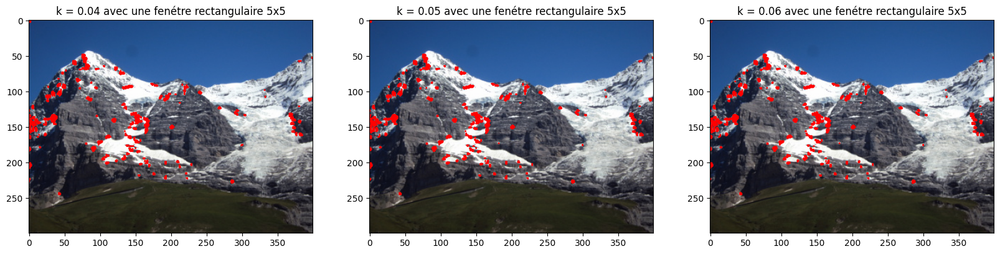

In [8]:
fig, ax = plt.subplots(nrows=1, ncols=3, figsize=(20, 10))
for i in range(3):
    _, keypoints = Dectecteur.haris_detector(images[0], K = k[i], methods_wds='rectangulaire', size_wds = 5)
    ax[(i % 3)].imshow(images[0], cmap='gray')
    ax[(i % 3)].scatter(keypoints[:, 1], keypoints[:, 0],s =1, facecolors='none', edgecolors='r')
    ax[(i % 3)].set_title(f"k = {k[i]} avec une fenétre rectangulaire 5x5")
    print(f"k = {k[i]} nombre de point {len(keypoints)}")
    

k = 0.04 nombre de point 6100
k = 0.05 nombre de point 6020
k = 0.06 nombre de point 5948


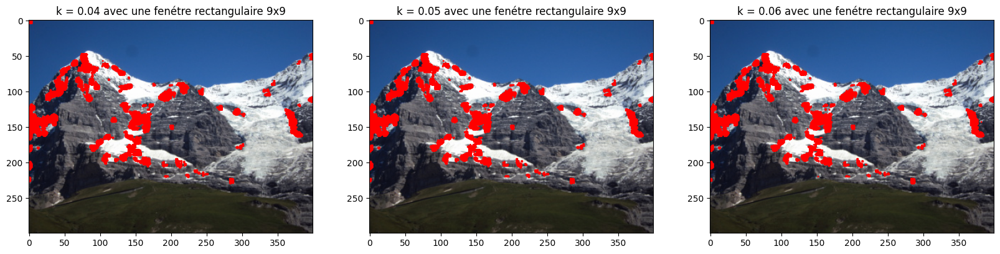

In [9]:
fig, ax = plt.subplots(nrows=1, ncols=3, figsize=(20, 10))
for i in range(3):
    _, keypoints = Dectecteur.haris_detector(images[0], K = k[i], methods_wds='rectangulaire', size_wds = 9)
    ax[(i % 3)].imshow(images[0], cmap='gray')
    ax[(i % 3)].scatter(keypoints[:, 1], keypoints[:, 0],s =1, facecolors='none', edgecolors='r')
    ax[(i % 3)].set_title(f"k = {k[i]} avec une fenétre rectangulaire 9x9")
    print(f"k = {k[i]} nombre de point {len(keypoints)}")

k = 0.04 nombre de point 1816
k = 0.05 nombre de point 1708
k = 0.06 nombre de point 1627


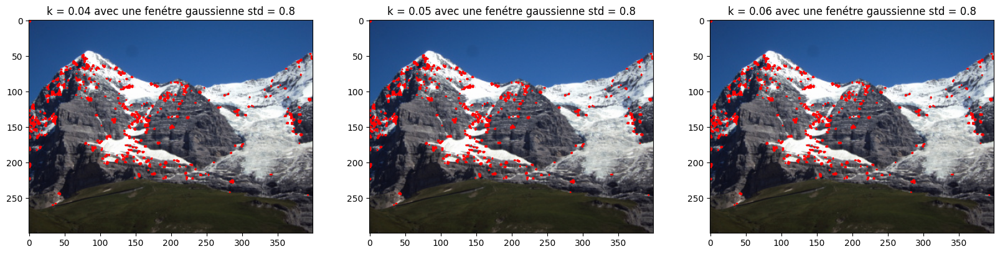

In [10]:

fig, ax = plt.subplots(nrows=1, ncols=3, figsize=(20, 10))
for i in range(3):
    _, keypoints = Dectecteur.haris_detector(images[0], K = k[i], methods_wds='gaussienne', std_dev = 0.8)
    ax[(i % 3)].imshow(images[0], cmap='gray')
    ax[(i % 3)].scatter(keypoints[:, 1], keypoints[:, 0],s =1, facecolors='none', edgecolors='r')
    ax[(i % 3)].set_title(f"k = {k[i]} avec une fenétre gaussienne std = 0.8")
    print(f"k = {k[i]} nombre de point {len(keypoints)}")
    

k = 0.04 nombre de point 2706
k = 0.05 nombre de point 2684
k = 0.06 nombre de point 2622


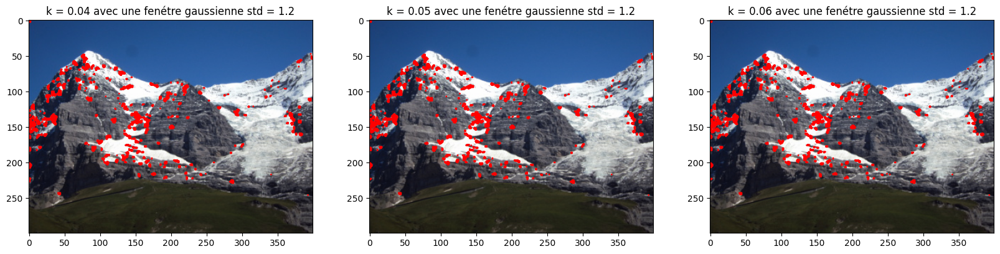

In [11]:
fig, ax = plt.subplots(nrows=1, ncols=3, figsize=(20, 10))
for i in range(3):
    _, keypoints = Dectecteur.haris_detector(images[0], K = k[i], methods_wds='gaussienne', std_dev = 1.2)
    ax[(i % 3)].imshow(images[0], cmap='gray')
    ax[(i % 3)].scatter(keypoints[:, 1], keypoints[:, 0],s =1, facecolors='none', edgecolors='r')
    ax[(i % 3)].set_title(f"k = {k[i]} avec une fenétre gaussienne std = 1.2")
    print(f"k = {k[i]} nombre de point {len(keypoints)}")

k = 0.04 nombre de point 3388
k = 0.05 nombre de point 3255
k = 0.06 nombre de point 3133


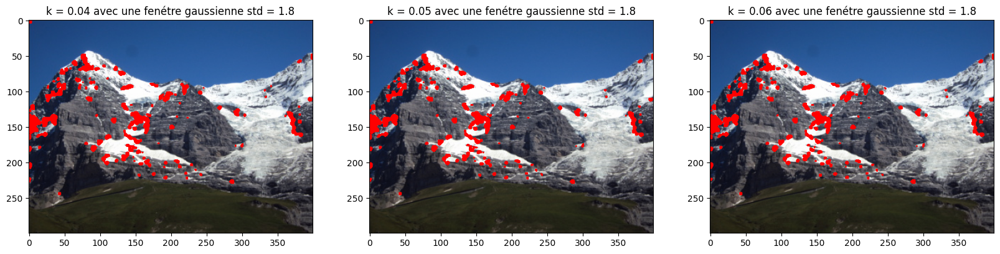

In [12]:
fig, ax = plt.subplots(nrows=1, ncols=3, figsize=(20, 10))
for i in range(3):
    _, keypoints = Dectecteur.haris_detector(images[0], K = k[i], methods_wds='gaussienne', std_dev = 1.8)
    ax[(i % 3)].imshow(images[0], cmap='gray')
    ax[(i % 3)].scatter(keypoints[:, 1], keypoints[:, 0],s =1, facecolors='none', edgecolors='r')
    ax[(i % 3)].set_title(f"k = {k[i]} avec une fenétre gaussienne std = 1.8")
    print(f"k = {k[i]} nombre de point {len(keypoints)}")

Une fenêtre plus grande capturer des variations d'intensité sur une plus grande échelle, ce qui peut conduire à la détection de coins sur une plus grande étendue de l'image. En revanche, une fenêtre plus petite peut détecter des coins plus fins, mais elle est sensible au bruit.
En changent le paramétre K on arrive a contrôler la sensibilité du détecteur.

**(d) Points d'interet avec de rotation sur l'image.**

Text(0.5, 1.0, 'fenétre rectangulaire 3x3, nombre de point 263')

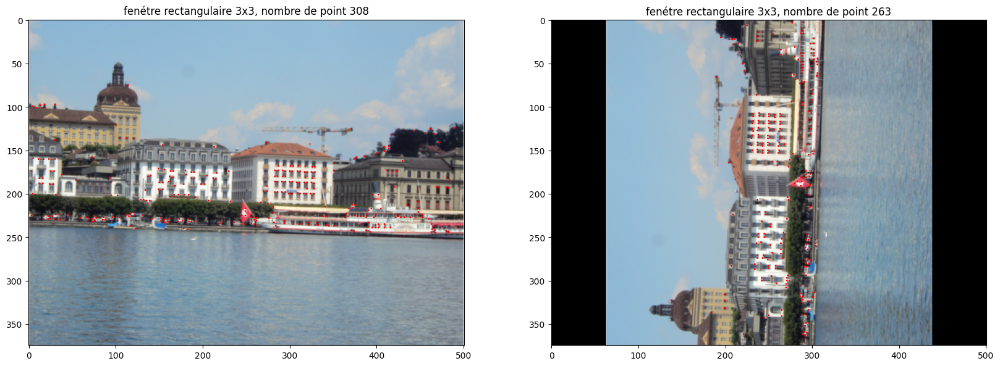

In [13]:
imgs_process = Image_processing()
image_rotate = imgs_process.rotate_image(images[4], 90)
fig, ax = plt.subplots(nrows=1, ncols=2, figsize=(20, 10))
_, keypoints = Dectecteur.haris_detector(images[4], K = 0.08, methods_wds='rectangulaire', size_wds = 3, remover=True)
_, keypoints_rotate = Dectecteur.haris_detector(image_rotate, K = 0.06, methods_wds='rectangulaire', size_wds = 3, remover=True)
ax[0].imshow(images[4], cmap='gray')
ax[0].scatter(keypoints[:, 1], keypoints[:, 0],s =1, facecolors='none', edgecolors='r')
ax[0].set_title(f"fenétre rectangulaire 3x3, nombre de point {len(keypoints)}")
ax[1].imshow(image_rotate, cmap='gray')
ax[1].scatter(keypoints_rotate[:, 1], keypoints_rotate[:, 0],s =1, facecolors='none', edgecolors='r')
ax[1].set_title(f"fenétre rectangulaire 3x3, nombre de point {len(keypoints_rotate)}")

Lorsque on effectue une rotation de l'image, les points d'intérêt détectés sur cette image tournée ne seront pas les mêmes que ceux de l'image originale.
Pour que les points d'intérêt détectés sur l'image tournée correspondent aux points d'intérêt de l'image originale, on doit adapter le paramètre k du détecteur de Harris. Le paramètre k est utilisé pour ajuster la sensibilité de la détection.

**(d) Harris avec la matrice hessienne.**

Text(0.5, 0.98, 'Harris detector avec hessienne')

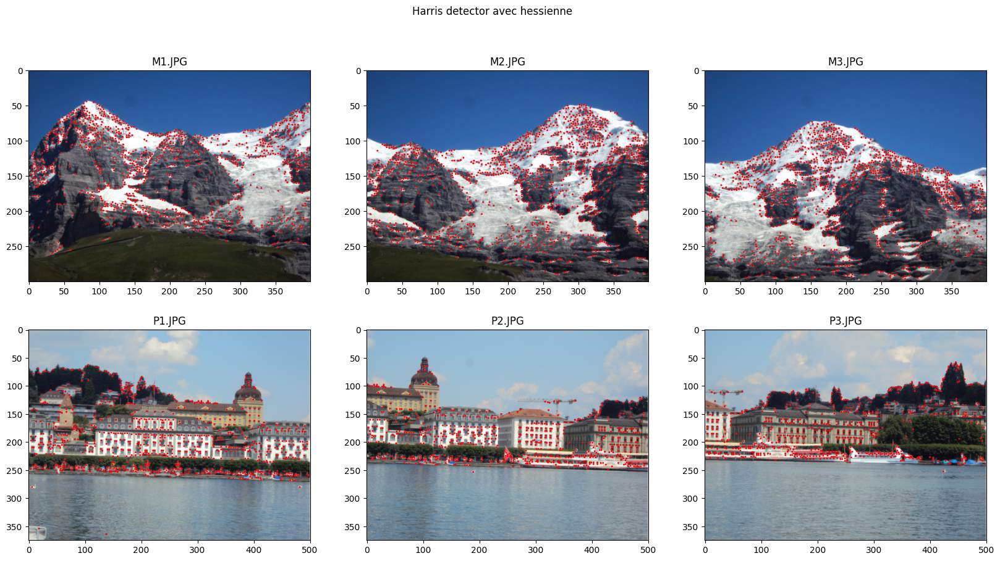

In [14]:

fig, ax = plt.subplots(nrows=2, ncols=3, figsize=(20, 10))
for i, img in enumerate(images):
    _, keypoints = Dectecteur.haris_detector_hessienne(img, remover=True)
    ax[(i//3), (i % 3)].imshow(images[i], cmap='gray')
    ax[(i//3), (i % 3)].scatter(keypoints[:, 1], keypoints[:, 0],s =1, facecolors='none', edgecolors='r')
    ax[(i//3), (i % 3)].set_title(f"{titles[i]}")
fig.suptitle("Harris detector avec hessienne")

- ### Détecteur FAST 

##### Algorithme :

1 - Selectionner un pixel $p_0$ dans l'image d'intensité $Ip_0 \newline$
2 - Considérez un cercle de 16 pixels $p_i$ avec i = {1,2,...,16} autour du pixel.$\newline$
3 - Sélectionner un treshold $t$ approprié. $\newline$
4 - Chaque pixel parmi ces 16 pixels voisins peut avoir l'un des trois états suivants: $\newline$
$$
V_i = \left\{
    \begin{array}{ll}
        1  \space\space \space si \space \space  Ip_i > Ip_0 + t\\
        -1 \space\space \space si \space \space Ip_i < Ip_0 - t \\
        0 \space\space \space \space sinon
        
    \end{array}
\right.
$$
5 - Maintenant, le pixel $p_0$ est un coin s'il existe un ensemble de n pixels continus dans le cercle (de 16 pixels) qui sont tous plus lumineux que $I_p + t$, ou tous plus sombres que $I_p - t$.

https://docs.opencv.org/3.4/df/d0c/tutorial_py_fast.html

- Pour un seuil t = 0.2 et n = 12

Text(0.5, 0.98, 'Fast detector avec n = 12 et t = 0.2')

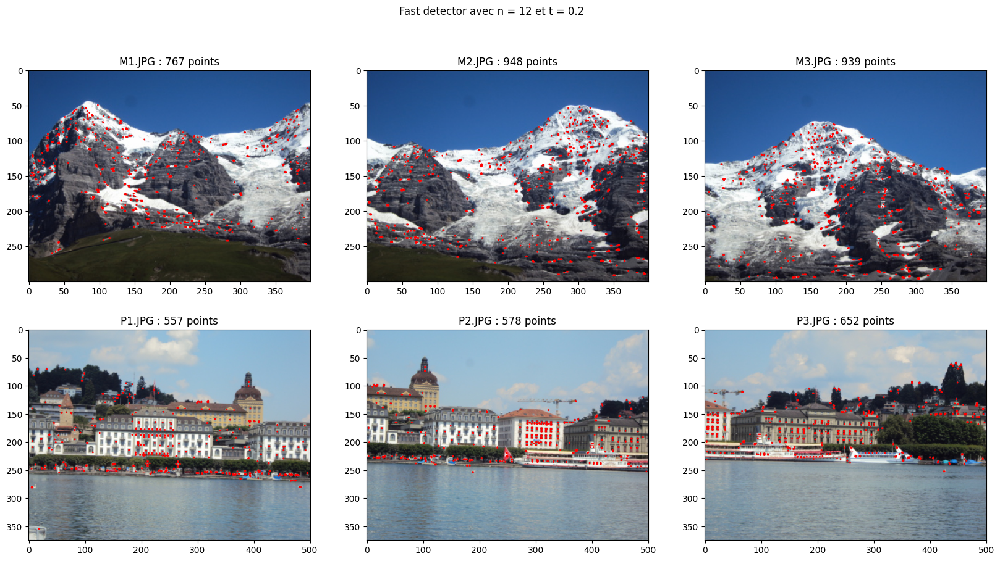

In [15]:
Dectecteur = Coins_detector()
fig, ax = plt.subplots(nrows=2, ncols=3, figsize=(20, 10))
for i, img in enumerate(images):
    Kpntfast = Dectecteur.fast_detector(img)
    ax[(i//3), (i % 3)].imshow(images[i], cmap='gray')
    ax[(i//3), (i % 3)].scatter(Kpntfast[:, 1], Kpntfast[:, 0],s =1, facecolors='none', edgecolors='r')
    ax[(i//3), (i % 3)].set_title("{} : {} points".format(titles[i],len(Kpntfast)))
fig.suptitle("Fast detector avec n = 12 et t = 0.2")

- Pour un seuil t = 0.4 et n = 12

Text(0.5, 0.98, 'Fast detector avec n = 12 et t = 0.4')

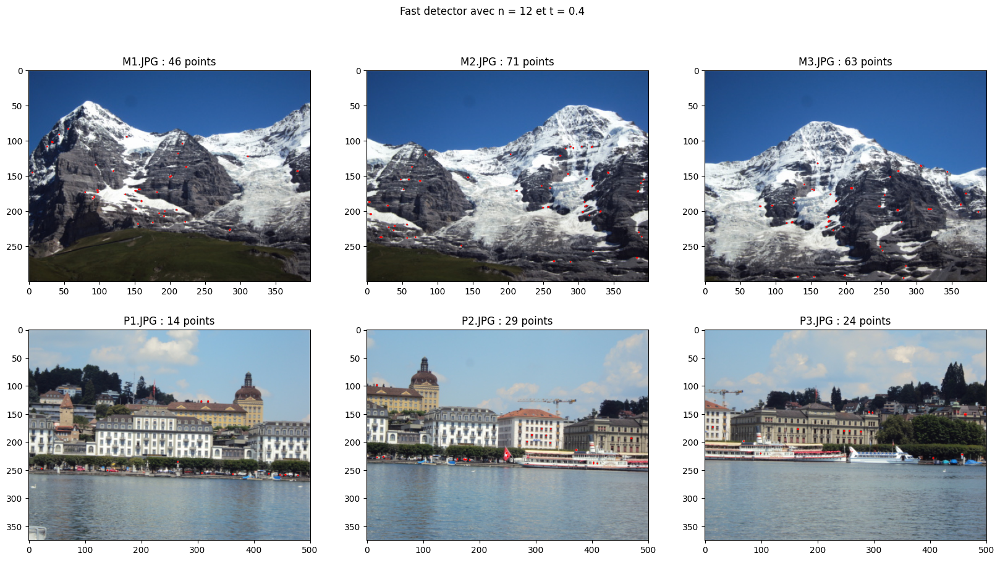

In [16]:
fig, ax = plt.subplots(nrows=2, ncols=3, figsize=(20, 10))
for i, img in enumerate(images):
    Kpntfast = Dectecteur.fast_detector(img, t = 0.4)
    ax[(i//3), (i % 3)].imshow(images[i], cmap='gray')
    ax[(i//3), (i % 3)].scatter(Kpntfast[:, 1], Kpntfast[:, 0],s =1, facecolors='none', edgecolors='r')
    ax[(i//3), (i % 3)].set_title("{} : {} points".format(titles[i],len(Kpntfast)))
fig.suptitle("Fast detector avec n = 12 et t = 0.4")

**Remarque** : le seuil choisi influence le nombre de points detectés tel que plus le seuil est grand plus on aura moins de coins detectés

**(b) Implémenter la suppression des non-maximas locaux**

Text(0.5, 0.98, 'Fast detector avec n = 12 et t = 0.2 avec suppression de non-maximas locaux')

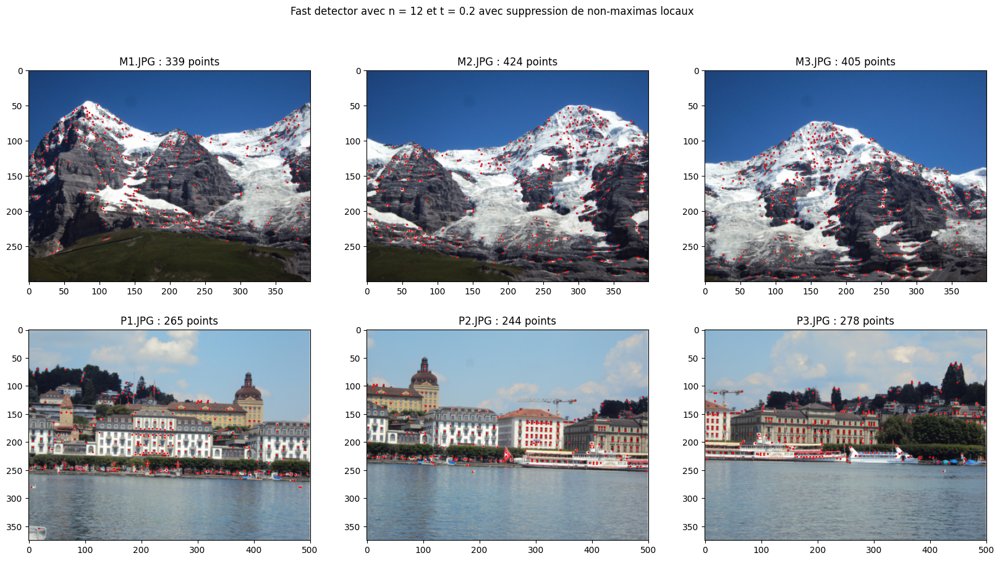

In [17]:
fig, ax = plt.subplots(nrows=2, ncols=3, figsize=(20, 10))
for i, img in enumerate(images):
    Kpntfast = Dectecteur.fast_detector(img, remover = True)  # on active le remover
    ax[(i//3), (i % 3)].imshow(images[i], cmap='gray')
    ax[(i//3), (i % 3)].scatter(Kpntfast[:, 1], Kpntfast[:, 0],s =1, facecolors='none', edgecolors='r')
    ax[(i//3), (i % 3)].set_title("{} : {} points".format(titles[i],len(Kpntfast)))
fig.suptitle("Fast detector avec n = 12 et t = 0.2 avec suppression de non-maximas locaux")

 Nombre de points éliminés: 44.20%


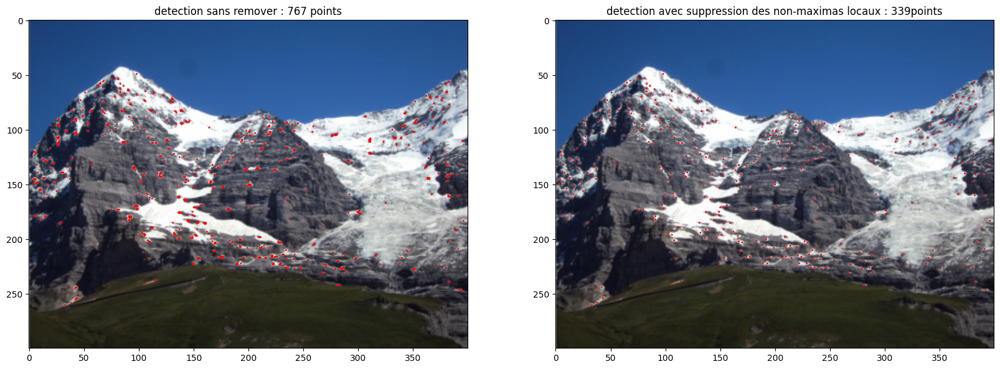

In [18]:
keypoints = Dectecteur.fast_detector(images[0])
keypoints_remover = Dectecteur.fast_detector(images[0], remover = True)
fig, ax = plt.subplots(nrows=1, ncols=2, figsize=(20, 10))

ax[0].imshow(images[0], cmap='gray')
ax[0].scatter(keypoints[:, 1], keypoints[:, 0],s =1, facecolors='none', edgecolors='r')
ax[0].set_title("detection sans remover : {} points".format(len(keypoints)))
ax[1].imshow(images[0], cmap='gray')
ax[1].scatter(keypoints_remover[:, 1], keypoints_remover[:, 0],s =1, facecolors='none', edgecolors='r')
ax[1].set_title("detection avec suppression des non-maximas locaux : {}points".format(len(keypoints_remover)))

score = len(keypoints_remover)/len(keypoints)
print(' Nombre de points éliminés: {:.2f}%'.format(score*100))

**(d) Points d'interet avec de rotation sur l'image.**

Text(0.5, 1.0, 'image avec rotation : 828points')

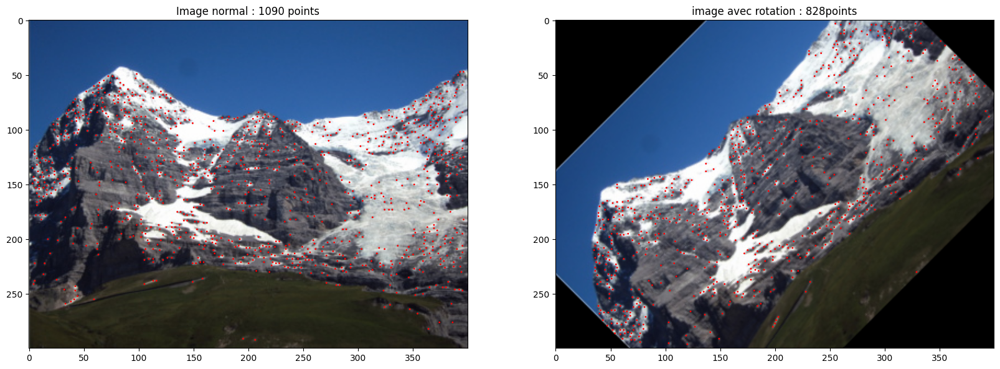

In [19]:
imgs_process = Image_processing()
image_rotate = imgs_process.rotate_image(images[0], 45)
fig, ax = plt.subplots(nrows=1, ncols=2, figsize=(20, 10))
keypoints = Dectecteur.fast_detector(images[0], t = 0.1,remover = True)
keypoints_rotate = Dectecteur.fast_detector(image_rotate,t = 0.1, remover = True)
ax[0].imshow(images[0], cmap='gray')
ax[0].scatter(keypoints[:, 1], keypoints[:, 0],s =1, facecolors='none', edgecolors='r')
ax[0].set_title("Image normal : {} points".format(len(keypoints)))
ax[1].imshow(image_rotate, cmap='gray')
ax[1].scatter(keypoints_rotate[:, 1], keypoints_rotate[:, 0],s =1, facecolors='none', edgecolors='r')
ax[1].set_title("image avec rotation : {}points".format(len(keypoints_rotate)))

**Remarque** : On remarque qu'il y'a certains points détectés dans l'image de gauche (image avant rotation) qui n'apparaissent pas sur l'image de droite(image après rotation), mais la majorité des points restent similaires. Il faudrait jouer sur le paramètre de seuil $t$ pour améliorer ceci.

Text(0.5, 1.0, 'M1.JPG : 339 points')

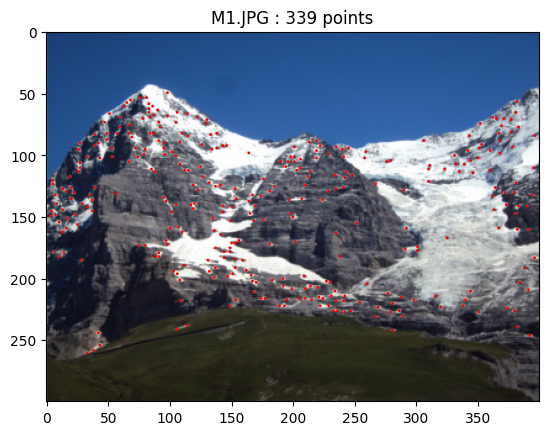

In [20]:
t0 = time.time()
keypoints_fast = Dectecteur.fast_detector(images[0],remover = True)
time_fast = time.time() - t0
plt.figure()
plt.imshow(images[0], cmap='gray')
plt.scatter(keypoints_fast[:, 1], keypoints_fast[:, 0],s =1, facecolors='none', edgecolors='r')
plt.title("{} : {} points".format(titles[0],len(keypoints_fast)))


Text(0.5, 1.0, 'M1.JPG : 259 points')

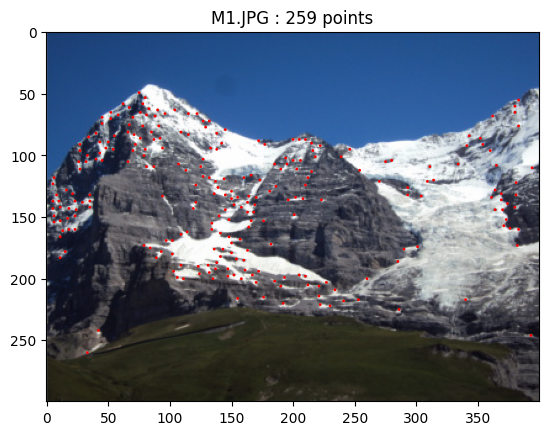

In [21]:
t1 = time.time()
_, keypoints_harris = Dectecteur.haris_detector(images[0], K = 0.04, methods_wds='rectangulaire', size_wds = 3, remover=True, suppression_size=5)
time_Harris = time.time() - t1
plt.figure()
plt.imshow(images[0], cmap='gray')
plt.scatter(keypoints_harris[:, 1], keypoints_harris[:, 0],s =1, facecolors='none', edgecolors='r')
plt.title("{} : {} points".format(titles[0],len(keypoints_harris)))


In [22]:
print(" Le temps de calcul nécessaire à la méthode fast :  ",time_fast)
print(" Le temps de calcul nécessaire à la méthode de Harris :  ",time_Harris)

 Le temps de calcul nécessaire à la méthode fast :   1.3556547164916992
 Le temps de calcul nécessaire à la méthode de Harris :   0.16328215599060059


**Remarques** : 

- Vitesse de détection : La méthode de détection de Harris est plus rapide que la méthode de détection de Fast.

- Sensibilité aux variations d'échelle : Le détecteur de Harris peut détecter des points d'intérêt à différentes échelles. En revanche, le détecteur FAST est plus adapté à la détection de points d'intérêt à une échelle spécifique.

- Sensibilité aux rotations : Le détecteur de Harris est plus sensible aux rotations que le détecteur FAST, ce qui signifie que les points d'intérêts varient plus si l'image est tournée pour Harris que pour FAST.

- ### Bonus : Implémentation des fonctions avec OpenCV

In [23]:
import cv2

def harris_corner_detector(image, block_size=5, ksize=3, k=0.04, threshold=0.1):
    
    """
            Détecte les points d'intérêt dans une image en utilisant le détecteur de Harris de openCV.

            Args:
                image_path (ndarray): Image d'entrée.
                block_size (int): Paramètre qui spécifie la taille de la fenêtre utilisée pour calculer la matrice de l'auto-corrélation des gradients.
                ksize (int): Paramètre qui spécifie la taille du noyau du filtre de Sobel, qui est utilisé pour calculer les gradients de l'image dans les directions x et y.
                k (float) : Paramètre qui influence la sensibilité de la détection de coins aux variations d'intensité.

            Returns:
                ndarray: Image contenant les points d'intérêt détectés.

    """
    

    # Convertir l'image en niveaux de gris
    image1 = image.copy()
    gray = cv2.cvtColor(image1, cv2.COLOR_BGR2GRAY)

    # Calculer les coins de Harris
    dst = cv2.cornerHarris(gray, block_size, ksize,k)

    # Dilater les coins détectés pour une meilleure visualisation
    dst = cv2.dilate(dst, None)
     # Définir un seuil pour détecter les coins
    corner_mask = dst > threshold * dst.max()

    # Dessiner les coins sur l'image
    image1[corner_mask] = [0, 0, 255]  # Colorer les coins en rouge
    
    # Retourner l'image avec les coins détectés
    return image1



def fast_corner_detector(image):

    """
            Détecte les points d'intérêt dans une image en utilisant le détecteur FAST de openCV.

            Args:
                image_path (ndarray): Image d'entrée.

            Returns:
                ndarray: Image contenant les points d'intérêt détectés.

    """
    # Charger l'image
    image1 = image.copy()
    gray_image = cv2.cvtColor(image1, cv2.COLOR_BGR2GRAY)

    # Créer le détecteur FAST
    fast_detector = cv2.FastFeatureDetector_create()

    # Détecter les coins FAST
    keypoints = fast_detector.detect(gray_image, None)
    print(keypoints)
    # Dessiner des cercles autour des coins détectés
    for keypoint in keypoints:
        x, y = map(int, keypoint.pt)
        image1 = cv2.circle(image1, (x, y), 1, (0, 0, 255), -1)

    return image1


Text(0.5, 0.98, 'Harris detector de OpenCV')

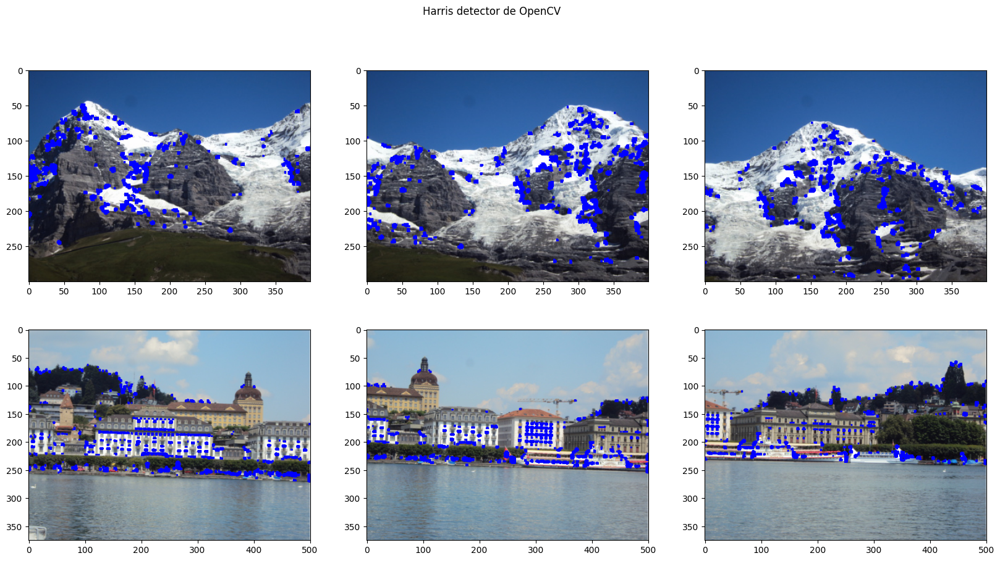

In [24]:
fig, ax = plt.subplots(nrows=2, ncols=3, figsize=(20, 10))
for i, img in enumerate(images):
    image = harris_corner_detector(img)  # on active le remover
    ax[(i//3), (i % 3)].imshow(image, cmap='gray')
fig.suptitle("Harris detector de OpenCV")

(< cv2.KeyPoint 0000025207A6FD20>, < cv2.KeyPoint 0000025209CBB420>, < cv2.KeyPoint 0000025209CE7F90>, < cv2.KeyPoint 0000025209CE7FC0>, < cv2.KeyPoint 0000025209CF7030>, < cv2.KeyPoint 0000025209CF7060>, < cv2.KeyPoint 0000025209CF70C0>, < cv2.KeyPoint 0000025209CF70F0>, < cv2.KeyPoint 0000025209CF7120>, < cv2.KeyPoint 0000025209CF7150>, < cv2.KeyPoint 0000025209CF7180>, < cv2.KeyPoint 0000025209CF71B0>, < cv2.KeyPoint 0000025209CF71E0>, < cv2.KeyPoint 0000025209CF7210>, < cv2.KeyPoint 0000025209CF7240>, < cv2.KeyPoint 0000025209CF7270>, < cv2.KeyPoint 0000025209CF72A0>, < cv2.KeyPoint 0000025209CF72D0>, < cv2.KeyPoint 0000025209CF7300>, < cv2.KeyPoint 0000025209CF7330>, < cv2.KeyPoint 0000025209CF7360>, < cv2.KeyPoint 0000025209CF7390>, < cv2.KeyPoint 0000025209CF73C0>, < cv2.KeyPoint 0000025209CF73F0>, < cv2.KeyPoint 0000025209CF7420>, < cv2.KeyPoint 0000025209CF7450>, < cv2.KeyPoint 0000025209CF7480>, < cv2.KeyPoint 0000025209CF74B0>, < cv2.KeyPoint 0000025209CF74E0>, < cv2.KeyPoin

Text(0.5, 0.98, 'Fast detector de OpenCV')

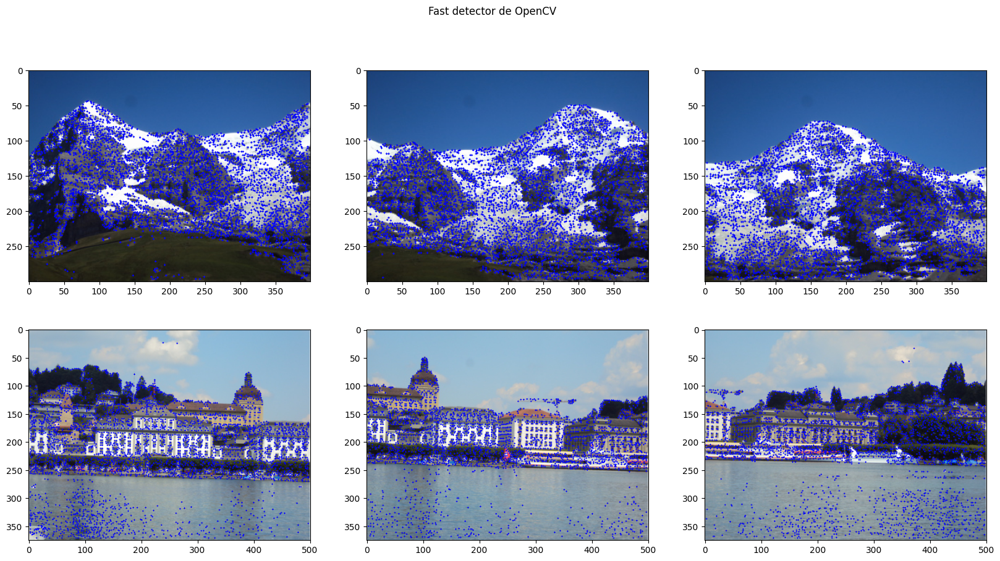

In [25]:
fig, ax = plt.subplots(nrows=2, ncols=3, figsize=(20, 10))
for i, img in enumerate(images):
    image = fast_corner_detector(img)  # on active le remover
    ax[(i//3), (i % 3)].imshow(image, cmap='gray')
fig.suptitle("Fast detector de OpenCV")

**Remarque** : niveau temps de calcul les méthodes de détection d'harris et de fast de openCV sont largement plus rapide que celles qu'on a implémenté car il s'agit de fonctions optimisés

## EXERCICE 02 : DESCRIPTION ET MATCHINGS DES POINTS D'INTERETS.


**a- Pour chaque point d’interét, récupérer un bloc de pixels autour de celui-ci et transformer le en vecteur.**

**b- implementer une methode de matching capable de gerer les mauvais matchs**

Utilisation norme L1

Text(0.5, 1.0, 'taille du bloc 5x5 norme L1')

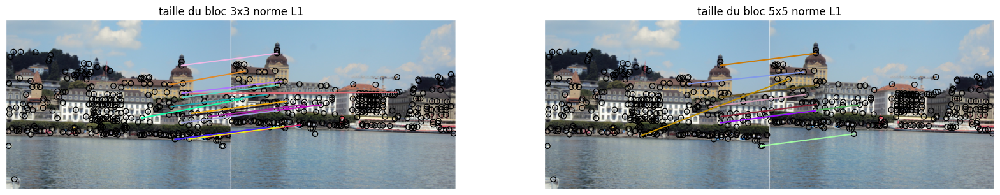

In [26]:
Dectecteur = Coins_detector()
Kpntfast_image1 = Dectecteur.fast_detector(images[3], remover=True)
Kpntfast_image2 = Dectecteur.fast_detector(images[4], remover=True)

match_pnt = Matching(images[3],images[4], Kpntfast_image1, Kpntfast_image2,seuil = 0.04, neighbor_size= 3)
matchs =match_pnt.matching()

match_pnt1 = Matching(images[3],images[4], Kpntfast_image1, Kpntfast_image2,seuil = 0.04, neighbor_size= 5)
matchs1 =match_pnt1.matching()


from skimage.feature import plot_matches
fig, ax = plt.subplots(nrows=1, ncols=2, figsize=(20, 15))
plot_matches(ax[0], images[3], images[4], Kpntfast_image1, Kpntfast_image2,  matchs)
ax[0].axis('off')
ax[0].set_title("taille du bloc 3x3 norme L1")
plot_matches(ax[1], images[3], images[4], Kpntfast_image1, Kpntfast_image2, matchs1)
ax[1].axis('off')
ax[1].set_title("taille du bloc 5x5 norme L1")

**Remarque** : Pour s'assurer que le matching est capable de gérer les mauvais matchs, on utilise l'apariement croisé additionné à une comparaison des distances, tel que on commence d'abords par vérifier les distances des descripteurs de chaque point de l'image 1 avec les descripteurs de chaque point de l'image 2, puis on somme et on récupère les indices des sommes minimales. Une fois les indices de ces distances minimales entre descripteurs des points d'interet de chaque image trouvé, on fait l'appariement croisé qui vérifie que l'indice de la distance minimale dans l'image 1 dans l'image 2 est le meme que celui de l'image 2 dans l'image 1 pour assuré un bon match. Finalement, on devra choisir un seuil idéal.   

**c- Etudier l'influence de la taille du bloc**

**Remarque** : plus la taille de la fenétre est grande, plus nous obtenons d'informations sur la région environnante du point d'intérêt. inversement plus la taille est plus petite cela entraîne une perte d'informations, augmentant ainsi le risque d'erreurs de matching.

- **Etude des metrics** 

Utilisation de la norme L2

Text(0.5, 1.0, 'taille du bloc 5x5 norme L2')

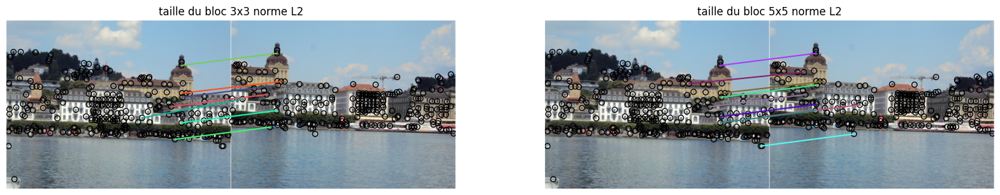

In [27]:
Kpntfast_image1 = Dectecteur.fast_detector(images[3], remover=True)
Kpntfast_image2 = Dectecteur.fast_detector(images[4], remover=True)

match_pnt = Matching(images[3],images[4], Kpntfast_image1, Kpntfast_image2,seuil = 0.04, neighbor_size= 3,metric = "Norm_L2")
matchs =match_pnt.matching()

match_pnt1 = Matching(images[3],images[4], Kpntfast_image1, Kpntfast_image2,seuil = 0.05, neighbor_size= 5,metric = "Norm_L2")
matchs1 =match_pnt1.matching()


from skimage.feature import plot_matches
fig, ax = plt.subplots(nrows=1, ncols=2, figsize=(20, 15))
plot_matches(ax[0], images[3], images[4], Kpntfast_image1, Kpntfast_image2, matchs)
ax[0].axis('off')
ax[0].set_title("taille du bloc 3x3 norme L2")
plot_matches(ax[1], images[3], images[4], Kpntfast_image1, Kpntfast_image2, matchs1)
ax[1].axis('off')
ax[1].set_title("taille du bloc 5x5 norme L2")

**Remarque** : 

- L'utilisation de la métrique norme L2 (corrélation) est plus coûteux en termes de calcul que la norme L1 en raison du calcul de la racine carrée.

- La norme L2 est plus sensible aux petites différences entre les descripteurs car elle donne plus de poids aux correspondances qui sont très similaires en termes de valeurs. La norme L1 est plus tolérante aux légères variations ce qui donne des correspondances de descripteurs qui sont moins similaires en termes de valeurs.

**(d) Rotation de l'une des images**

Text(0.5, 1.0, 'Rotation\xa0180°')

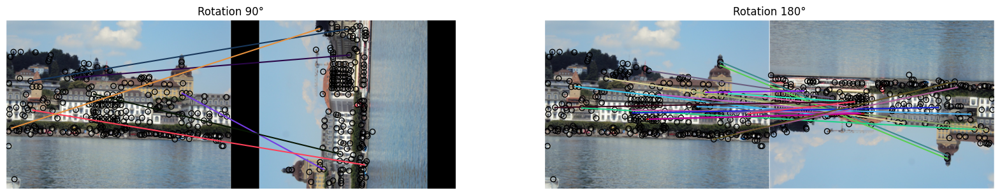

In [28]:
image_rotate = imgs_process.rotate_image(images[4], 90)
image_rotate2 = imgs_process.rotate_image(images[4], 180)
keypoints = Dectecteur.fast_detector(images[3], remover=True)
keypoints_rotate = Dectecteur.fast_detector(image_rotate, remover=True)
keypoints_rotate2 = Dectecteur.fast_detector(image_rotate2, remover=True)

match_pnt = Matching(images[3],image_rotate, keypoints, keypoints_rotate,seuil = 0.09, neighbor_size= 5,metric = "Norm_L2")
matchs =match_pnt.matching()

match_pnt1 = Matching(images[3],image_rotate2, keypoints, keypoints_rotate2,seuil = 0.09, neighbor_size= 5,metric = "Norm_L2")
matchs1 =match_pnt1.matching()

fig, ax = plt.subplots(nrows=1, ncols=2, figsize=(20, 15))
plot_matches(ax[0], images[3], image_rotate, keypoints, keypoints_rotate, matchs)
ax[0].axis('off')
ax[0].set_title("Rotation 90°")
plot_matches(ax[1], images[3], image_rotate2, keypoints, keypoints_rotate2, matchs1)
ax[1].axis('off')
ax[1].set_title("Rotation 180°")

**REMARQUE**: Les appariements obtenus ne sont pas les mêmes que précédemment. Cela est dû au descripteur utilisé, notre descripteur n'est pas invariant à la rotation.  

Solution: est d'utilisé un autre descripteur tels que le LBPV qui est invariant à la rotation.

- ##### Utilisation de la bibliothèque openCV et le descripteur SIFT 

In [29]:
import cv2

def match_images(image1, image2):
    # Convertir les images en niveaux de gris
    gray1 = cv2.cvtColor(image1, cv2.COLOR_BGR2GRAY)
    gray2 = cv2.cvtColor(image2, cv2.COLOR_BGR2GRAY)

    # Créer un détecteur SIFT
    sift = cv2.SIFT_create()

    # Détecter les points d'intérêt et les descripteurs dans chaque image
    keypoints1, descriptors1 = sift.detectAndCompute(gray1, None)
    keypoints2, descriptors2 = sift.detectAndCompute(gray2, None)

    # Créer un matcheur de descripteurs
    matcher = cv2.BFMatcher()

    # Trouver les correspondances entre les descripteurs des deux images
    matches = matcher.match(descriptors1, descriptors2)

    # Trier les correspondances par distance croissante
    matches = sorted(matches, key=lambda x: x.distance)

    # Retourner les correspondances
    return matches,keypoints1,keypoints2


Text(0.5, 1.0, 'Matchs en utilisant le descripteur sift et matches de openCV')

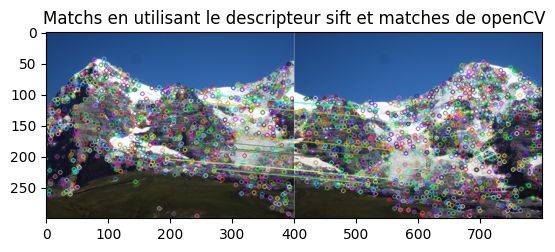

In [30]:
# Appeler la fonction pour trouver les correspondances
matches,keypoints1,keypoints2= match_images(images[0], images[1])
# Dessiner les correspondances sur une nouvelle image
matched_image = cv2.drawMatches(images[0], keypoints1, images[1], keypoints2, matches[:10], outImg=None)
plt.figure()
plt.imshow(matched_image,cmap='gray')
plt.title('Matchs en utilisant le descripteur sift et matches de openCV')